In [ ]:
!pip install ydata-profiling
!pip install kneed

# importar paquetes
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import os
from ydata_profiling  import ProfileReport

%matplotlib inline

#para poder visualizar todas las filas y columnas
pd.options.display.max_rows=None
pd.options.display.max_columns=None
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
le = LabelEncoder()

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 357.5/357.5 kB 5.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 395.8/395.8 kB 22.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 12.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 41.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 34.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 82.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 63.2 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=1173a5bb2bcc99c41fb799fc38e24bd063e7991051da27fb06a8889b837d1eba
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin
  Attempting uninstall: typing-extensions
    Found existing installation: typing_extensions 4.5.0
 

In [ ]:
#Lectura de bd final
df_final = pd.read_csv("df_egresos_final.csv")

In [ ]:
# Dimensión de la bd final
df_final.shape

(1900, 109)

In [ ]:
#Visualización de bd final
df_final.head(3)

,NRODOC,SEXO,MUNICIPIO,BARRIO,PRIMERA CLASE FUNCIONAL,ÚLTIMA CLASE FUNCIONAL,Clasificación IMC,Calificación (Índice de Fragilidad),Calificación (Apoyo Monopodal),Calificación Velocidad,Test Findrisc,Índice Tobillo/Brazo,Presión arterial registro medico,Diabetes Mellitus,Tipo diabetes mellitus,Tiempo con el diagnóstico,Control Diabetes,Tiene HTA,Control HTA,Tiene riesgo de tener HTA,Tiempo con el diagnóstico1,Tiene EPOC,Enfermedad Coronaria (En el último año),Insuficiencia Cardíaca,Valvulopatía,Arritmia o paciente con dispositivo,Sufre de alguna enfermedad cardiovascular,Tabaquismo,Cuantos cigarrillos día,Clasificación de Framinghan,Estadio de la Enfermedad Renal,Clase Funcional,Basciloscopia,Úlcera de pie diabético,Remisión,Diagnóstico Principal,Análisis y conducta a seguir,Tiene próximo control,Tipo control,Requiere cita de morbilidad,Ambito según el médico,Atención,Ingreso,Peso,Talla,IMC,Saturación de Oxígeno (%),Perímetro Muslo,Perímetro Cintura,Pliegue Triceps,Pliegue Abdomen,Pliegue Muslo,Sumatoria Pliegues,Presión Arterial Sistólica,Presión Arterial Diastólica,Frecuencia Cardíaca en reposo,Auto-calificacion Nivel de Ejercicio,Constantes,METS -Índice Metabólico,VO2 - Máxima Cantidad de Oxígeno,Índice de Fragilidad Groningen,Tiempo en Segundos (Apoyo Monopodal),Tiempo en Segundos (Recorrer 5 metros),Velocidad (m/s),Glicemia,Hemoglobina Glicada,Años de Consumo,Lipoproteina,HDL,Colesterol total,Trigliceridos,Creatinina 1 consulta,Tasa de Filtración Glomerular TFG,Microalbuminuria,Hormona Estimulante de la Tiroides (TSH),Creatinina 2 consulta,Tasa de Filtración Glomerular TFG2,Meses de diferencia entre TFG,Cambio de TFG,YEAR,MES,SERVICIO HABILITADO COD,REGIMEN AFILIACION,EPS VALIDADA,MODALIDAD CONTRATO,FUENTE FINANCIACION1,FUENTE FINANCIACION2,SERVICIO ADMITE,VIA INGRESO,BLOQUE,UNIDAD ESTRATEGICA,PISO,NRO CAMA,SERVICIO EGRESO,TIPO EGRESO,DEMORA ASIGNACION CAMA,DEMORA APLICACION MEDICAMENTO,DEMORA SALIDA CLINICA (DIAS),TRANSFUSION SANGRE,ANTIBIOTICO,ALTA MEDICA,DX RELACIONADO1 COD,DX RELACIONADO2 COD,DX RELACIONADO3 COD,DX PRINCIPAL EGRESO CAPITULO COD,PROFESIONAL ESPECIALIDAD,PROFESIONAL ESPECIALIDAD GRD,EDAD,estancia
0,306222,F,MEDELLIN,PRADO CENTRO,CLASE FUNCIONAL 2A,CLASE FUNCIONAL 2A,Obesidad Grasa,Normal,Malo - Fragil,Aceptable,Alta Probabilidad de Diabetes,0.91 - 1.30 Normal,120/65/Sentado,No,ND,ND,No aplica,Si,Controlada,No aplica,ND,No,No aplica,No aplica,No,Si,Si,No,ND,Bajo riesgo,Estadio 0,Clase funcional 2A,No aplica,No,Grupal 2,I10X - HIPERTENSION ESENCIAL (PRIMARIA),Comprometidos con la seguridad de nuestros pac...,ND,Médico,ND,Ambulatorio,5.036516e+06,3.394202e+06,74.666667,158.666667,29.7050,95.166667,45.333333,102.666667,19.0,38.666667,27.333333,85.000,117.833333,69.833333,64.333333,1.333333,0.106667,6.680150,23.380500,3.1666666666666665,1.500,4.833333,0.773333,90.33333333333333,2.6,0.0,39.666666666666664,46.53333333333333,112.53333333333335,64.5,0.6633333333333333,140.85166666666666,3.4,0.7933333333333333,0.8333333333333334,68.94333333333333,0.0,0.0,2021,8,101.0,Contributivo,NUEVA EPS S.A. PGP,PGP,NUEVA EPS,NUEVA EPS,Hospitalización,Consulta Externa ó Programada,Bloque 1,Hospitalizacion Adultos,Piso 5,527AN,Piso 5 Medicina Interna Norte,Alta Médica,1:38,-82:00,0.0,NO,NO,SI,I878,G401,G438,I00-I99,Medicina Interna,Medicina Interna,47.0,3.0
1,306223,F,MEDELLIN,SAMARIA,CLASE FUNCIONAL 4,CLASE FUNCIONAL 4,Obesidad Grasa,Frágil,Malo - Fragil,Malo - Frágil,Alta Probabilidad de Diabetes,0.91 - 1.30 Normal,Sin información,No,ND,ND,No aplica,No,No aplica,Alto riesgo,ND,No,No,No,No,No,No,Si,40,Bajo riesgo,Estadio 0,Clase funcional 4,No aplica Negativo,No,Grupal 4,F028 - DEMENCIA EN OTRAS ENFERMEDADES ESPECIFI...,1. Control medico en un mes con resultado de p...,ND,Médico,ND,Domiciliario,4.758786e+06,2.997755e+06,74.000000,159.000000,29.3300,95.000000,37.000000,107.000000,9.0,12.000000,9.000000,30.000,121.000000,79.500000,69.000000,1.000000,0.000000,4.963900,17.373650,12.0,0.000,0.000000,0.000000,40.5,2.93,30.0,0.0,19.89

In [ ]:
#Columnas de bd final
df_final.columns

Index(['NRODOC', 'SEXO', 'MUNICIPIO', 'BARRIO', 'PRIMERA CLASE FUNCIONAL',
       'ÚLTIMA CLASE FUNCIONAL', 'Clasificación IMC',
       'Calificación (Índice de Fragilidad)', 'Calificación (Apoyo Monopodal)',
       'Calificación Velocidad',
       ...
       'ANTIBIOTICO', 'ALTA MEDICA', 'DX RELACIONADO1 COD',
       'DX RELACIONADO2 COD', 'DX RELACIONADO3 COD',
       'DX PRINCIPAL EGRESO CAPITULO COD', 'PROFESIONAL ESPECIALIDAD',
       'PROFESIONAL ESPECIALIDAD GRD', 'EDAD', 'estancia'],
      dtype='object', length=109)

In [ ]:
# --- Reporte exploratorio del dataset ---
ProfileReport(df_final, title='Reporte exploratorio del dataset final', minimal=True,
              progress_bar=False, interactions=None, explorative=True, dark_mode=True,
              notebook={'iframe':{'height': '600px'}}, html={'style':{'primary_color': '#FFCC00'}},
              missing_diagrams={'heatmap': False, 'dendrogram': False}).to_notebook_iframe()

<ipython-input-8-3a80e01b363b>:4: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(df_final.corr(), annot = True, cmap='crest');


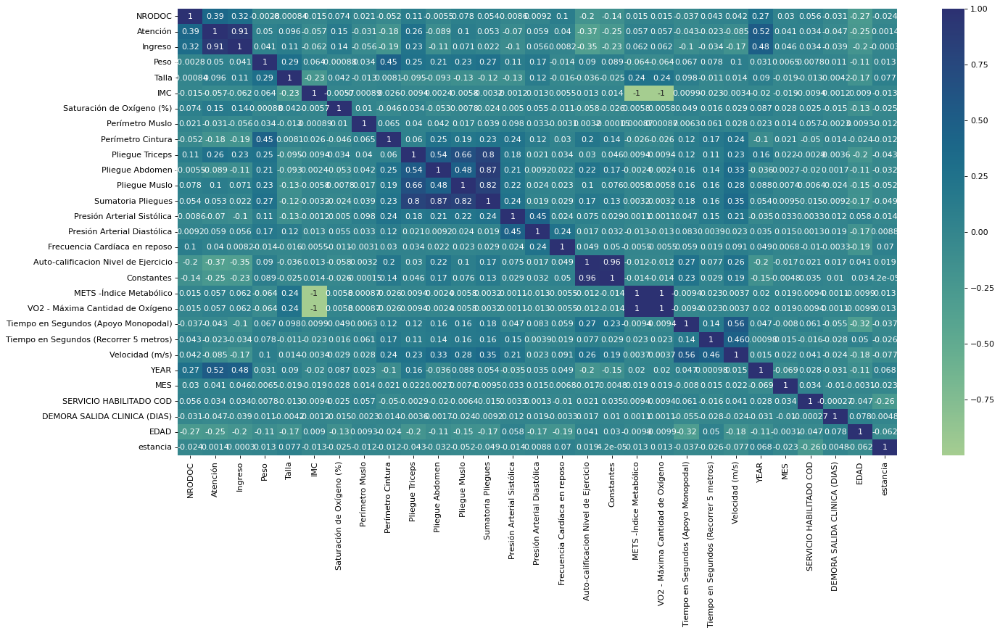

In [ ]:
#Analisis de correlación
from matplotlib.pyplot import figure
figure(figsize=(30, 10), dpi=80);
sns.heatmap(df_final.corr(), annot = True, cmap='crest');

<Axes: xlabel='EDAD'>

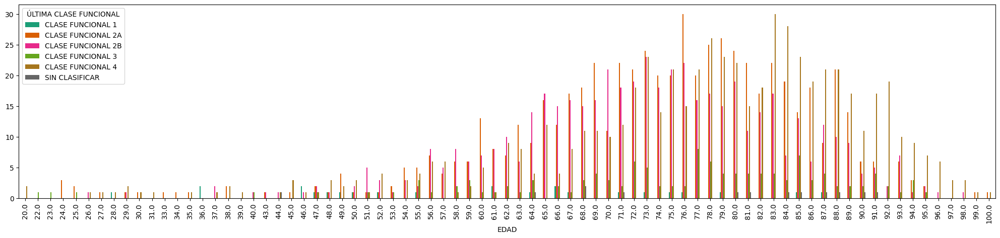

In [ ]:
# en cada clase funcional de que edad son los pacientes
pd.crosstab(index=df_final['EDAD'],
            columns=df_final['ÚLTIMA CLASE FUNCIONAL']).plot(kind='bar', figsize=(25,5), colormap='Dark2')

<Axes: ylabel='SEXO'>

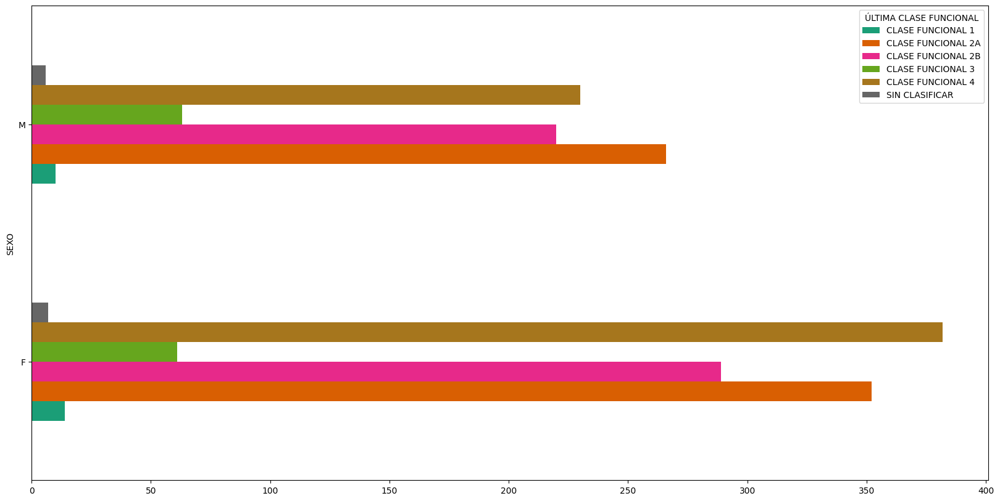

In [ ]:
# CLASE FUNCIONAL POR GENERO
pd.crosstab(index=df_final['SEXO'],
            columns=df_final['ÚLTIMA CLASE FUNCIONAL']).plot(kind='barh', figsize=(20,10), colormap='Dark2')

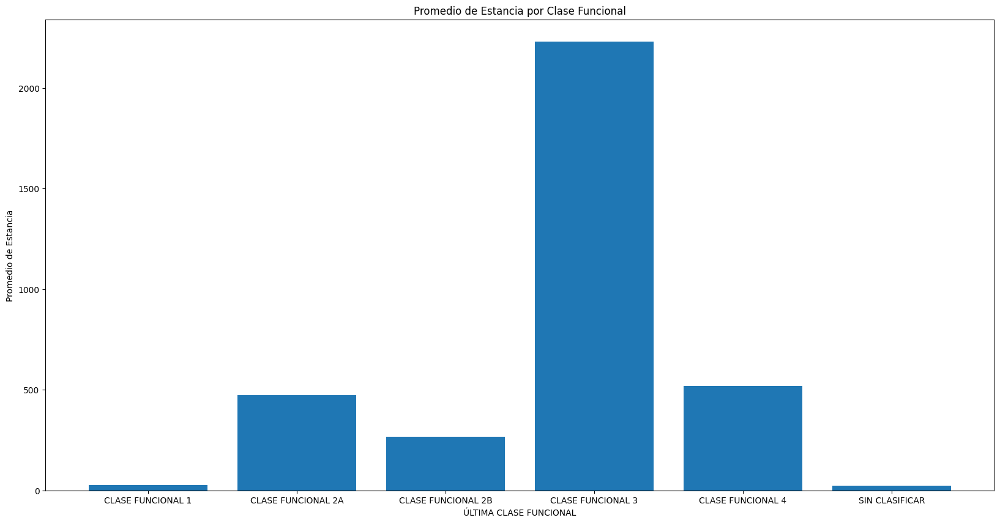

In [ ]:
#Promedio de IMC por ultima clase funcional
promedios = df_final.groupby("ÚLTIMA CLASE FUNCIONAL")["IMC"].mean().reset_index()
plt.figure(figsize=(20, 10))
plt.bar(promedios["ÚLTIMA CLASE FUNCIONAL"], promedios["IMC"])
plt.xlabel("ÚLTIMA CLASE FUNCIONAL")
plt.ylabel("Promedio de IMC")
plt.title("Promedio de IMC por Clase Funcional")
plt.show()

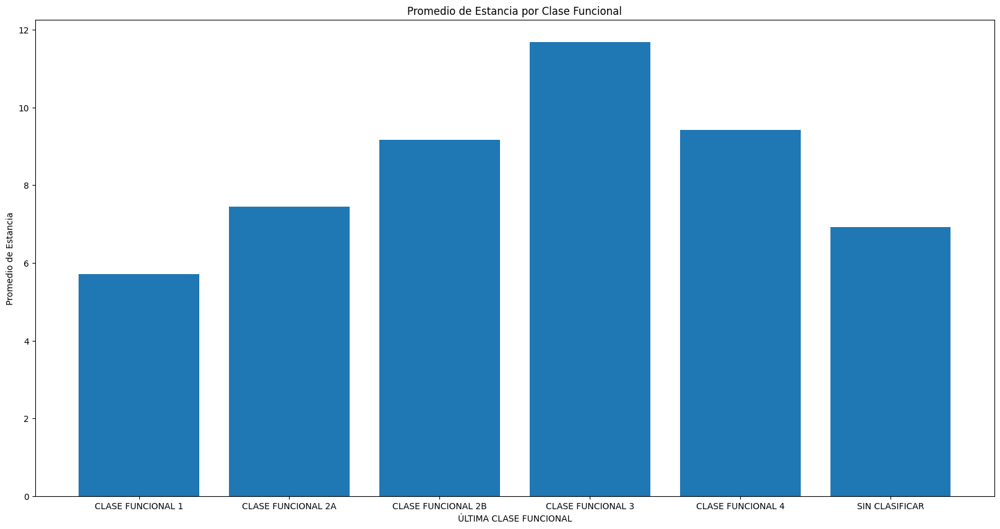

In [ ]:
#Promedio de estancia por ultima clase funcional
promedios = df_final.groupby("ÚLTIMA CLASE FUNCIONAL")["estancia"].mean().reset_index()
plt.figure(figsize=(20, 10))
plt.bar(promedios["ÚLTIMA CLASE FUNCIONAL"], promedios["estancia"])
plt.xlabel("ÚLTIMA CLASE FUNCIONAL")
plt.ylabel("Promedio de Estancia")
plt.title("Promedio de Estancia por Clase Funcional")
plt.show()

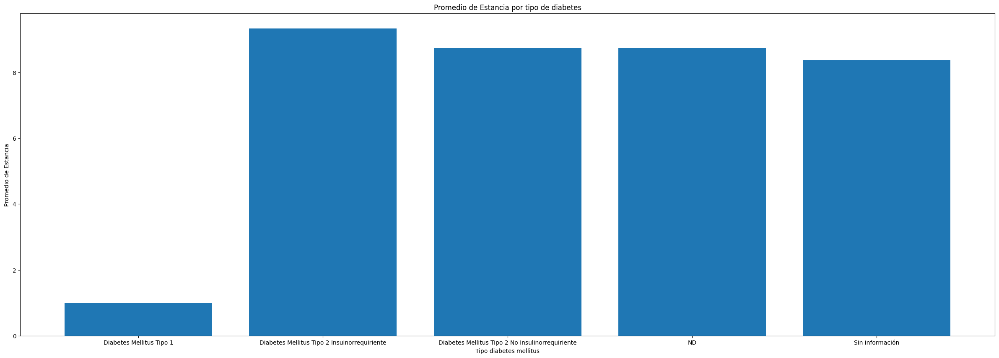

In [ ]:
#Promedio de estancia en tipo de diabetes
promedios = df_final.groupby("Tipo diabetes mellitus")["estancia"].mean().reset_index()
plt.figure(figsize=(30, 10))
plt.bar(promedios["Tipo diabetes mellitus"], promedios["estancia"])
plt.xlabel("Tipo diabetes mellitus")
plt.ylabel("Promedio de Estancia")
plt.title("Promedio de Estancia por tipo de diabetes")
plt.show()

<Axes: ylabel='SERVICIO EGRESO'>

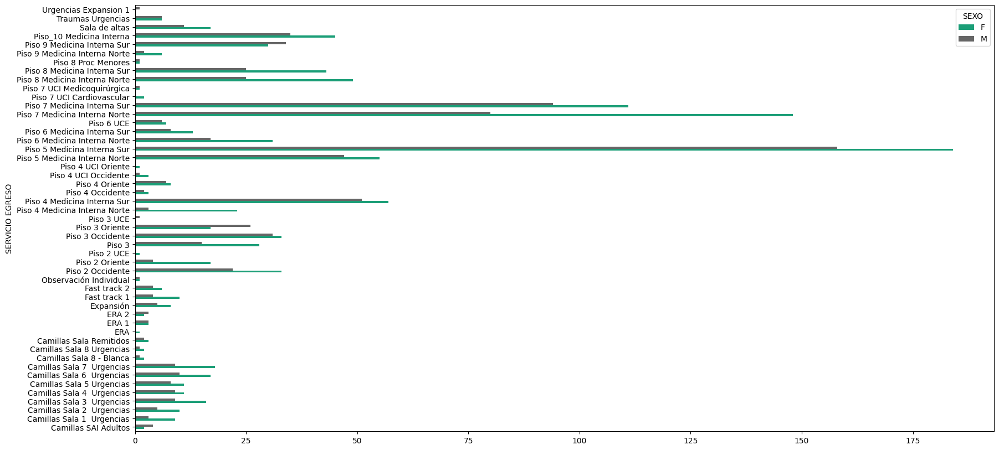

In [ ]:
# Servicio de egreso segun genero del paciente
pd.crosstab(index=df_final['SERVICIO EGRESO'],
            columns=df_final['SEXO']).plot(kind='barh', figsize=(20,10), colormap='Dark2')

<Axes: ylabel='TIPO EGRESO'>

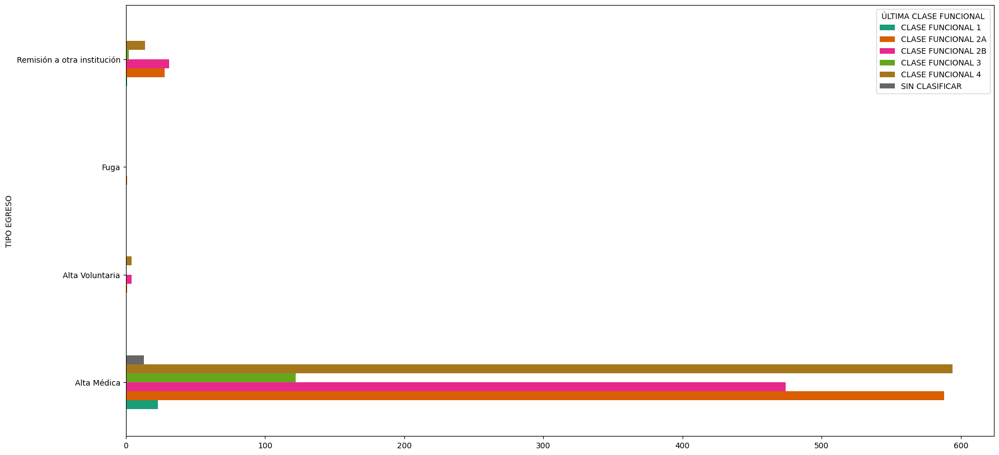

In [ ]:
# Tipo de egreso segun clase funcional
pd.crosstab(index=df_final['TIPO EGRESO'],
            columns=df_final['ÚLTIMA CLASE FUNCIONAL']).plot(kind='barh', figsize=(20,10), colormap='Dark2')

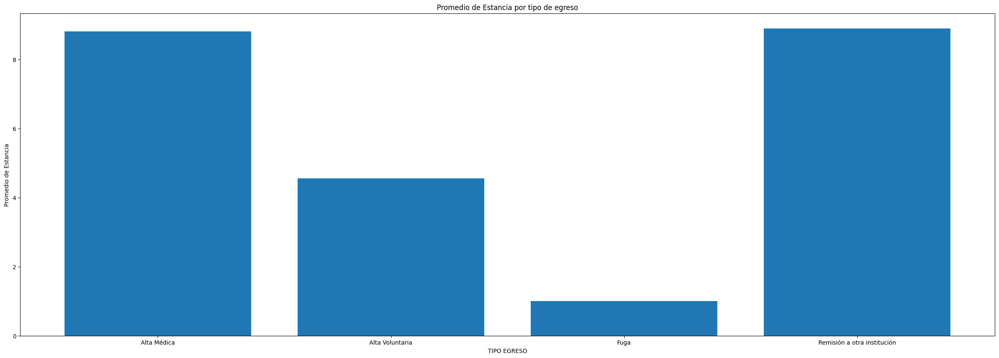

In [ ]:
#Promedio de estancia segun el tipo de egreso del paciente
promedios = df_final.groupby("TIPO EGRESO")["estancia"].mean().reset_index()
plt.figure(figsize=(30, 10))
plt.bar(promedios["TIPO EGRESO"], promedios["estancia"])
plt.xlabel("TIPO EGRESO")
plt.ylabel("Promedio de Estancia")
plt.title("Promedio de Estancia por tipo de egreso")
plt.show()